In [19]:
%load_ext autoreload
%autoreload 2

In [22]:
import os
import time
import random
import math

import pandas as pd
import torch
import torch.nn as nn
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from yolo.utils.google_utils import attempt_load
from yolo.utils.datasets import LoadStreams, LoadImages
from yolo.utils.general import (
    check_img_size, non_max_suppression, apply_classifier, scale_coords, xyxy2xywh, strip_optimizer)
from yolo.utils.plots import plot_one_box
from yolo.utils.torch_utils import select_device, load_classifier, time_synchronized

from yolo.models.models import *
from yolo.utils.datasets import *
from yolo.utils.general import *
from yolo.utils.plots import *

from rethink.models import create_pretrained_yolov7_backbone

from vision_data_engine.utils.similarity import compute_top_k_similar_imgs, get_worst_performing_images 
from vision_data_engine.utils.search import get_schreder_unlabeled_images, get_schreder_unused_images
from vision_data_engine.utils.visualization import plot_images_with_labels
from vision_data_engine.utils.general import get_class_names

In [2]:
names = get_class_names("../yolov7/data/schreder.names")

In [3]:
# model_all = "/media/magalhaes/output/test/data_schreder_pretrained/2023_01_19-10_27_37-0.61"
model_eval = "/media/magalhaes/vision/test/yolov7_tiny_1686142923_best_schreder"

model_weights = "/media/magalhaes/vision/checkpoints/yolov7_1686143097/weights/best.pt" 

In [4]:
TOP_N_WORST_IMAGES = 20
TOP_K_SIMILAR_IMAGES = 20

In [28]:
images_paths = get_worst_performing_images(model_eval, TOP_N_WORST_IMAGES, names, min_num_pred=2, ignore_classes=["car", "emergency_vehicle", "other", "bus", "motorcycle"])

In [29]:
images_paths

['/media/magalhaes/schreder/images/d5_1059_15794.jpg',
 '/media/magalhaes/schreder/images/d5_813_14519.jpg',
 '/media/magalhaes/schreder/images/d5_12287_4178.jpg',
 '/media/magalhaes/schreder/images/d5_163_14755.jpg',
 '/media/magalhaes/schreder/images/d5_16778_4859.jpg',
 '/media/magalhaes/schreder/images/d5_1544_16557.jpg',
 '/media/magalhaes/schreder/images/d5_16545_2883.jpg',
 '/media/magalhaes/schreder/images/d5_12254_12177.jpg',
 '/media/magalhaes/schreder/images/d5_3609_24457.jpg',
 '/media/magalhaes/schreder/images/d5_14069_21293.jpg',
 '/media/magalhaes/schreder/images/d5_11826_26443.jpg',
 '/media/magalhaes/schreder/images/d5_2267_11167.jpg',
 '/media/magalhaes/schreder/images/d5_13758_3477.jpg',
 '/media/magalhaes/schreder/images/d5_16256_25394.jpg',
 '/media/magalhaes/schreder/images/d5_2192_28738.jpg',
 '/media/magalhaes/schreder/images/d5_24556_17525.jpg',
 '/media/magalhaes/schreder/images/d5_3250_15676.jpg',
 '/media/magalhaes/schreder/images/d5_2517_8454.jpg',
 '/media

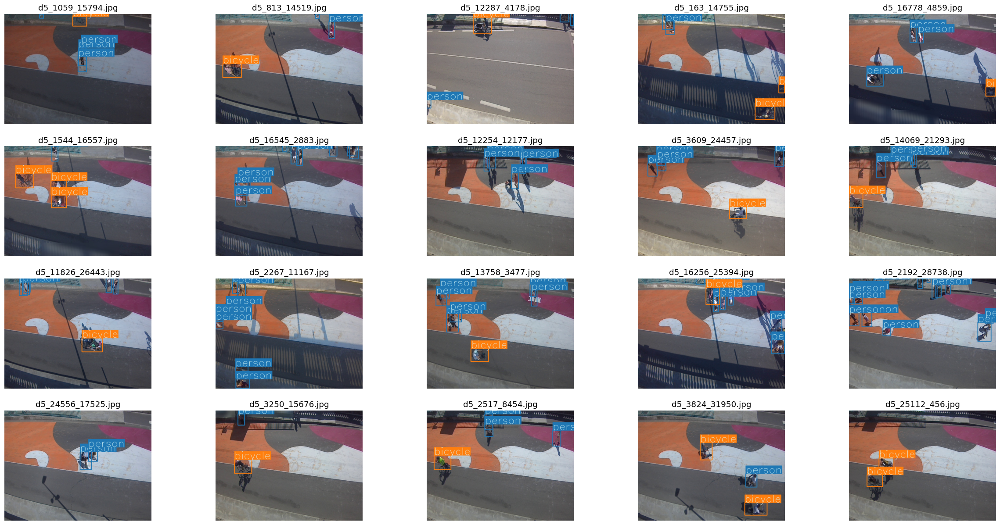

: 

In [30]:
fig = plot_images_with_labels(images_paths, names)
fig.show()

In [7]:
unused_imgs = get_schreder_unused_images("/media/magalhaes/schreder/images/", "/media/magalhaes/vision/datasets/vision_1686142386.txt", "/media/magalhaes/vision/datasets/vision_test_set.txt")

In [8]:
len(unused_imgs)

9302

In [9]:
model_backbone = create_pretrained_yolov7_backbone(0, "yolov7-backbone.yaml", model_weights)
model_backbone.linear_layers = nn.Flatten()


/home/guests/msg/.conda/envs/magalhaes/lib/python3.9/site-packages/torch/nn/init.py:388: UserWarning: Initializing zero-element tensors is a no-op
  warnings.warn("Initializing zero-element tensors is a no-op")


Loaded pretrained model with incompatible keys:  _IncompatibleKeys(missing_keys=['linear_layers.2.weight', 'linear_layers.2.bias', 'linear_layers.5.weight', 'linear_layers.5.bias'], unexpected_keys=['backbone.model.51.cv1.conv.weight', 'backbone.model.51.cv1.bn.weight', 'backbone.model.51.cv1.bn.bias', 'backbone.model.51.cv1.bn.running_mean', 'backbone.model.51.cv1.bn.running_var', 'backbone.model.51.cv1.bn.num_batches_tracked', 'backbone.model.51.cv2.conv.weight', 'backbone.model.51.cv2.bn.weight', 'backbone.model.51.cv2.bn.bias', 'backbone.model.51.cv2.bn.running_mean', 'backbone.model.51.cv2.bn.running_var', 'backbone.model.51.cv2.bn.num_batches_tracked', 'backbone.model.51.cv3.conv.weight', 'backbone.model.51.cv3.bn.weight', 'backbone.model.51.cv3.bn.bias', 'backbone.model.51.cv3.bn.running_mean', 'backbone.model.51.cv3.bn.running_var', 'backbone.model.51.cv3.bn.num_batches_tracked', 'backbone.model.51.cv4.conv.weight', 'backbone.model.51.cv4.bn.weight', 'backbone.model.51.cv4.bn.b

In [10]:
top_k_similar = compute_top_k_similar_imgs(images_paths, unused_imgs, model_backbone)

20it [00:03,  6.32it/s]
9299it [18:58,  8.17it/s]
100%|██████████| 20/20 [04:05<00:00, 12.29s/it]


Image: /media/magalhaes/schreder/day_test_set/images/117_snapshot_20230103T143258183_3fbe.jpg
Similar images:  /media/magalhaes/schreder/images/raw_30911_snapshot_20230127T162631441.jpg, /media/magalhaes/schreder/images/raw_31351_snapshot_20230127T162651697.jpg, /media/magalhaes/schreder/images/raw_32686_snapshot_20230127T162802697.jpg, /media/magalhaes/schreder/images/raw_31400_snapshot_20230127T162653722.jpg, /media/magalhaes/schreder/images/raw_31138_snapshot_20230127T162641621.jpg
Image: /media/magalhaes/schreder/day_test_set/images/134_snapshot_20230103T143258751_3f27.jpg
Similar images:  /media/magalhaes/schreder/images/raw_29887_snapshot_20230127T162534004.jpg, /media/magalhaes/schreder/images/raw_29846_snapshot_20230127T162531974.jpg, /media/magalhaes/schreder/images/raw_32739_snapshot_20230127T162804723.jpg, /media/magalhaes/schreder/images/raw_29927_snapshot_20230127T162536027.jpg, /media/magalhaes/schreder/images/raw_32785_snapshot_20230127T162806755.jpg
Image: /media/magalh

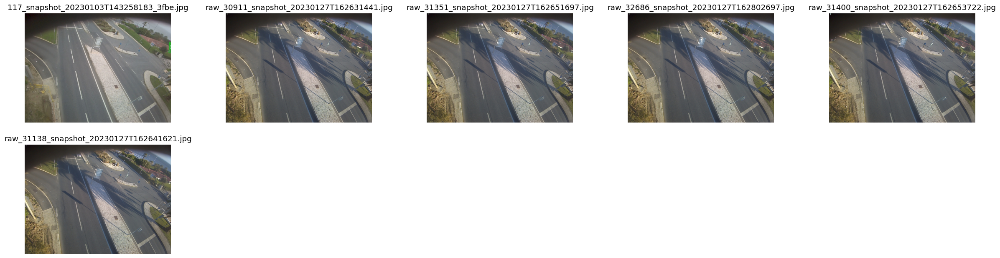

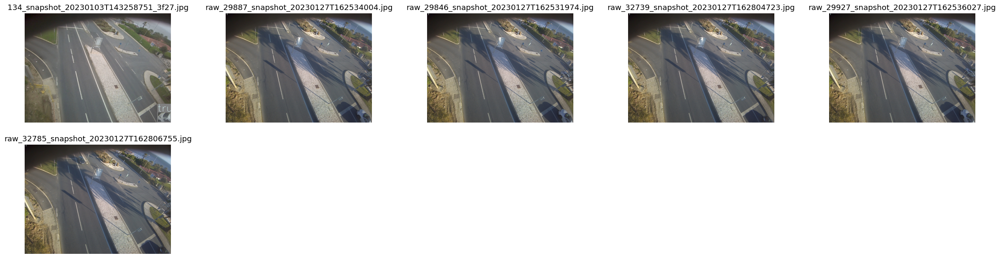

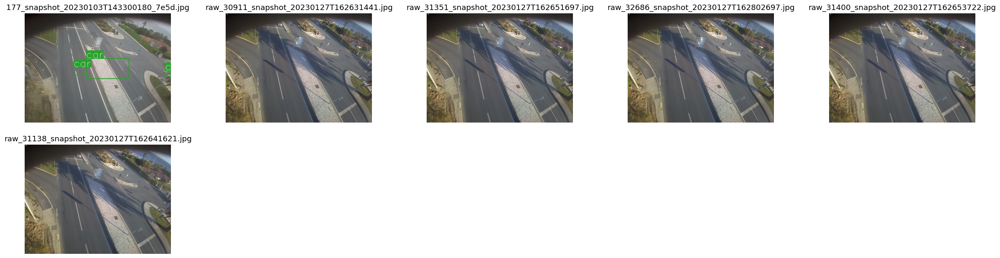

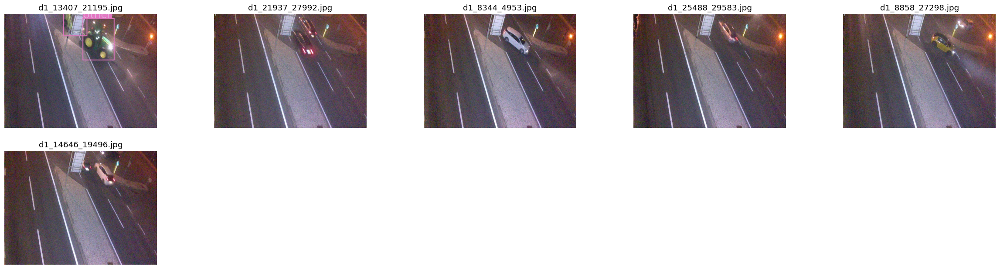

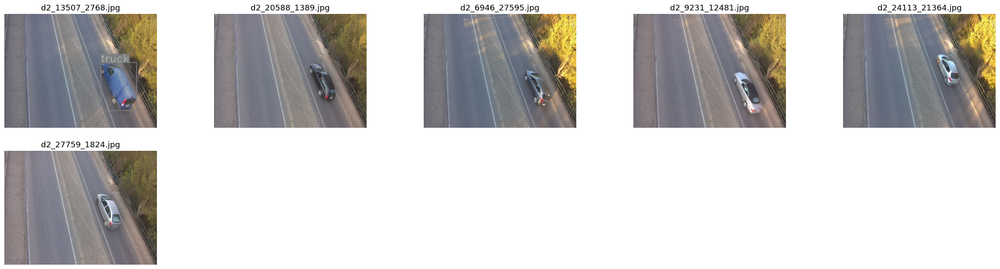

...

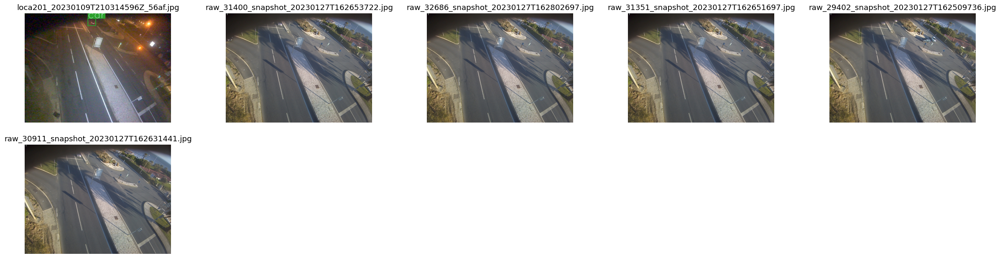

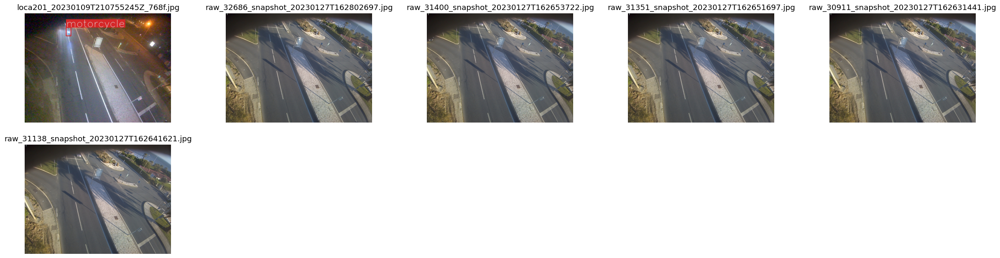

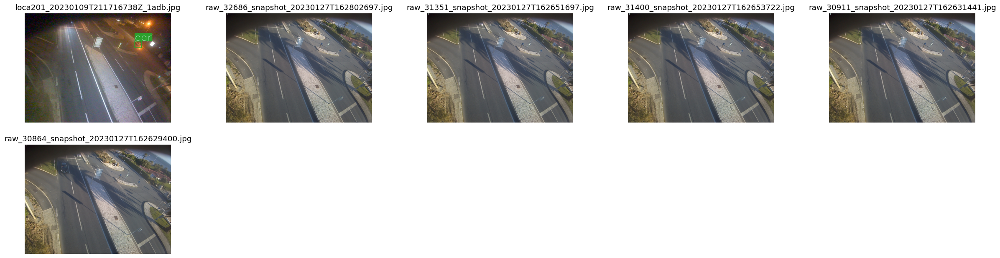

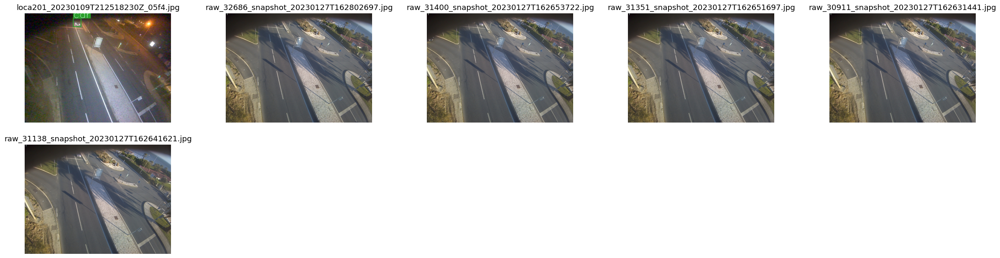

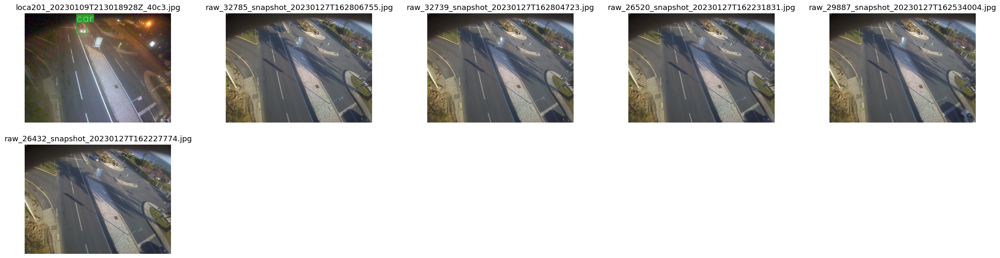

In [11]:
%matplotlib inline

for img_path, sim_imgs_paths in top_k_similar.items():
  print("===================")
  print(f"Image: {img_path}")
  print(f"Similar images: ", ", ".join(sim_imgs_paths))
  fig = plot_images_with_labels([img_path] + sim_imgs_paths, names)
  fig.show()

In [ ]:
top_k_similar_split2 = compute_top_k_similar_imgs(images_paths_split2, unused_imgs, model_backbone_split1)

100%|██████████| 10/10 [02:45<00:00, 16.54s/it]


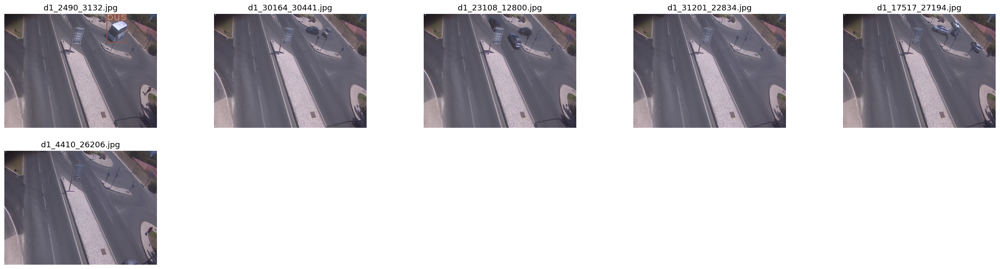

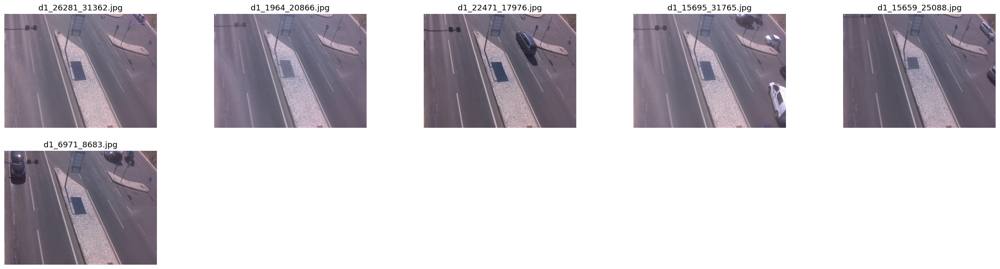

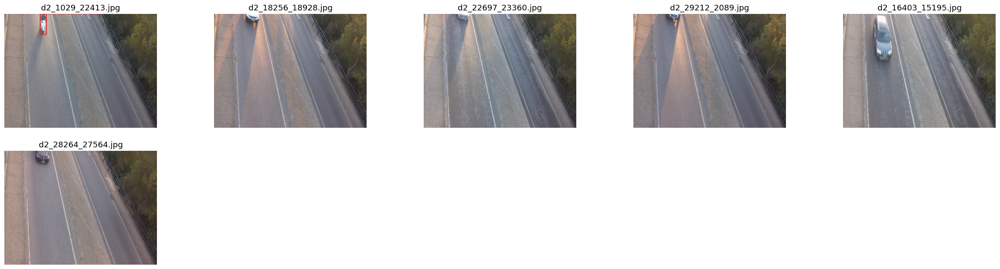

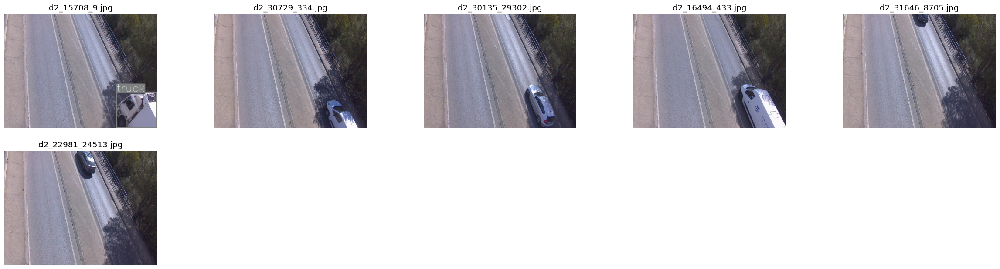

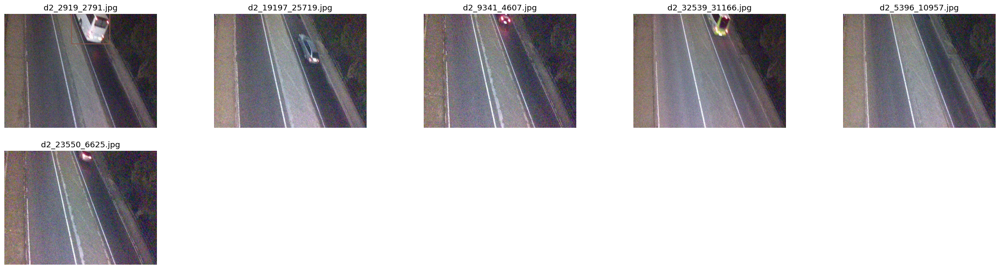

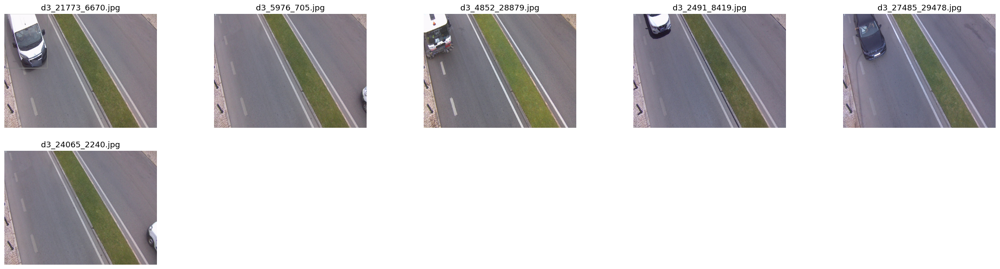

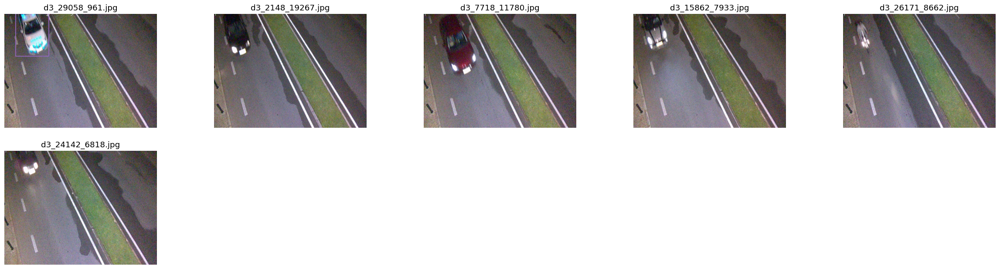

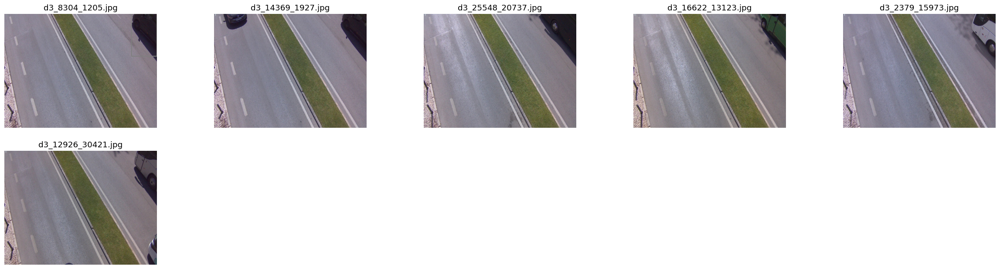

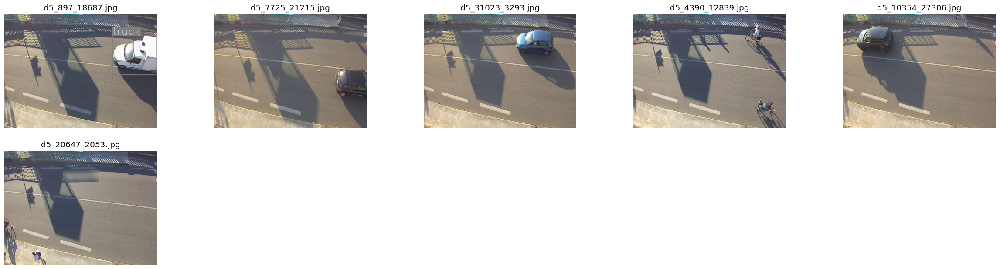

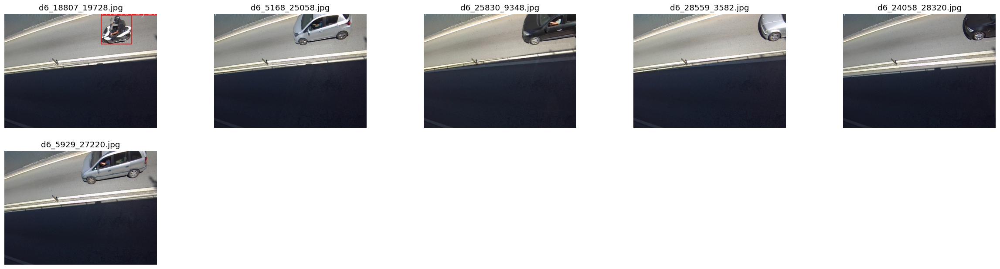

In [ ]:
%matplotlib inline

for img_path, sim_imgs_paths in top_k_similar_split2.items():
  fig = plot_images_with_labels([img_path] + sim_imgs_paths, names)
  fig.show()